# Gap Analysis Part 1 (Without Seasonality)

This document includes Python codes that conduct kernel density analysis and standard error prediction on water quality parameters **without seasonality**, including Total Nitrogen, Salinity, Dissolved Oxygen, Turbidity, and Secchi Depth.

The analysis is conducted in the separate managed areas of Charlotte Harbor, Estero Bay, Big Bend, Biscayne Bay, and Guana Tolomato.

Tasks:  


1. Create Kernel Density Maps for both continuous and discrete data points.  
    - **For data, without seasonality (Part 1):**  
        * Get all data from 2015 to 2019.  
        * Create shapefiles for each managed area and water parameters. 
        * Using Arcpy Kernel Density to create maps (KDE_Arcpy in arcgispro-py3 environment).<br><br>   
    - For data, with seasonality (Part 2):  
        * Get all data from 2015 to 2019.  
        * Define season according to season table.
        * Extract different four seasons, generate shapefiles in four folders.
        * Use the previously defined Generate Kernel Density method (Arcpy) to generate maps.
        * Add a season suffix to distinguish the generated files, and save them to one folder.<br><br>
    - Show KDE and SEP maps w/o seasons in pairs.


2. Calculate the average of rescaled SEP rasters in each managed area and parameter.  
    - **For data, without seasonality (Part 1):**  
        * Rescale the SEP raster from data from 2015 to 2019.  
        * Calculate and Plot Average Rescaled SEP.<br><br>
    - For data, with seasonality (Part 2):  
        * Using the rescaled SEP from Part 1.
        * Calculate and plot average rescaled SEP by season.  <br><br>   
    - Show KDE and SEP maps w/o seasons in pairs.<br><br>


**Part 1 Tasks**
* [1.Data Preprocess](#preprocessing)
* [2. Create Shapefile](#reg_create_shp)
* [3. Rescaled Standard Error Prediction](#reg_rescale)
    * [3.1 Charlotte Harbor](#reg_result_sep_ch)
    * [3.2 Estero Bay](#reg_result_sep_eb)
    * [3.3 Big Bend](#reg_result_sep_bb)
    * [3.4 Biscayne Bay Aquatic Preserve](#reg_result_sep_bbay)
    * [3.5 Guana Tolomato](#reg_result_sep_gtm)
* [4. Calculate Average Rescaled SEP](#reg_calculate_average)
    * [4.1 Charlotte Harbor](#reg_avg_rescale_sep_ch)
    * [4.2 Estero Bay](#reg_avg_rescale_sep_eb)
    * [4.3 Big Bend](#reg_avg_rescale_sep_bb)
    * [4.4 Biscayne Bay Aquatic Preserve](#reg_avg_rescale_sep_bbay)
    * [4.5 Guana Tolomato](#reg_avg_rescale_sep_gtm)
* [5. Plot Kernel Density Map & Standard Error Prediction Map](#reg_kde_sep)
    * [5.1 Charlotte Harbor](#reg_plot_pair_ch)
    * [5.2 Estero Bay](#reg_plot_pair_eb)
    * [5.3 Big Bend](#reg_plot_pair_bb)
    * [5.4 Biscayne Bay Aquatic Preserve](#reg_plot_pair_bbay)
    * [5.5 Guana Tolomato](#reg_plot_pair_gtm)

In [1]:
import pandas as pd
import geopandas as gpd
import os
from shapely.geometry import Point
import matplotlib.pyplot as plt
import glob
import contextily as cx
import warnings
warnings.filterwarnings('ignore')
import math
import rasterio
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import re
import shutil
import numpy.ma as ma
from rasterio.plot import show, plotting_extent
from collections import defaultdict
import importlib

import sys
sys.path.insert(0, '/Users/cong/Downloads/WaterQualityProject/SEACAR_WQ_Pilot-selected/git/misc')
import GapAnalysis
warnings.filterwarnings(action='once')
importlib.reload(GapAnalysis) # reload the GapAnalysis module after edit

<module 'GapAnalysis' from '/Users/cong/Downloads/WaterQualityProject/SEACAR_WQ_Pilot-selected/git/misc/GapAnalysis.py'>

# 1. Data Preprocessing <a class="anchor" id="preprocessing"></a>
Define the water quality parameter folders

In [2]:
# For kernel density estimation
gis_path = '/Users/cong/Downloads/WaterQualityProject/SEACAR_WQ_Pilot-selected/GIS_data/'
dfAll_orig = pd.read_csv(gis_path + r"all_0214.csv", low_memory=False)
gap_path = gis_path +'Gap_analysis/'
shp_folder = gap_path + r"Gap_SHP_All"
KDE_tif = gap_path + r'Gap_KDE_All'
boundary = gpd.read_file(gis_path + r"ORCP_Managed_Areas_Oct2021.shp")

# Store both KDE and SEP maps
kde_sep_files = gap_path + r"KDE_SEP_TIF_All"

In [3]:
# For standard error prediction
eps_path = gap_path + 'standard_error_prediction/'

# Store rescaled tif files
rescale_path_GSCHAP = eps_path + r"Rescaled_CharlotteHarbor"
rescale_path_EBAP = eps_path + r"Rescaled_EsteroBay"
rescale_path_BBSAP = eps_path + r"Rescaled_BigBend"
rescale_path_BBAP = eps_path + r"Rescaled_BiscayneBay"
rescale_path_GTMNERR = eps_path + r"Rescaled_GTMReserve"

boundary_path = gis_path + r"ORCP_Managed_Areas_Oct2021.shp"

## Store averaged tif files
avg_tif_GSCHAP = eps_path + r"AVG_SEP_GSCHAP"
avg_tif_EBAP = eps_path + r"AVG_SEP_EBAP"
avg_tif_BBSAP = eps_path + r"AVG_SEP_BBSAP"
avg_tif_BBAP = eps_path + r"AVG_SEP_BBAP"
avg_tif_GTMNERR = eps_path + r"AVG_SEP_GTMNERR"

In [4]:
# Select the year between 2015 to 2019
selected_dfAll_orig = dfAll_orig[(dfAll_orig['Year'] >= 2015) & (dfAll_orig['Year'] <= 2019)]

# 2. Create Shapefile <a class="anchor" id="reg_create_shp"></a>

In [5]:
managed_area_names = [
    'Gasparilla Sound-Charlotte Harbor Aquatic Preserve',
    'Estero Bay Aquatic Preserve',
    'Big Bend Seagrasses Aquatic Preserve',
    'Biscayne Bay Aquatic Preserve',
    'Guana Tolomato Matanzas National Estuarine Research Reserve'
]

parameter_names = ['Salinity', 'Total Nitrogen', 'Dissolved Oxygen', 'Turbidity', 'Secchi Depth']

In [6]:
GapAnalysis.delete_all_files(shp_folder)

In [ ]:
# Create shapefiles  for interested managed areas and parameters
GapAnalysis.create_shp(selected_dfAll_orig, managed_area_names, parameter_names, shp_folder)

In [8]:
GapAnalysis.classify_files_by_study_area(shp_folder)

# 3. Rescale Standard Error Prediction <a class="anchor" id="reg_rescale"></a>

## 3.1 Charlotte Harbor <a class="anchor" id="reg_result_sep_ch"></a>

In [9]:
GapAnalysis.delete_all_files(rescale_path_GSCHAP)

In [ ]:
GapAnalysis.rescale_tif_files(eps_path,'Charlotte Harbor', 2015, 2019, rescale_path_GSCHAP)

## 3.2 Estero Bay  <a class="anchor" id="reg_result_sep_eb"></a>

In [11]:
GapAnalysis.delete_all_files(rescale_path_EBAP)

In [ ]:
GapAnalysis.rescale_tif_files(eps_path,'Estero Bay', 2015, 2019, rescale_path_EBAP)

##  3.3 Big Bend <a class="anchor" id="reg_result_sep_bb"></a>

In [13]:
GapAnalysis.delete_all_files(rescale_path_BBSAP)

In [ ]:
GapAnalysis.rescale_tif_files(eps_path,'Big Bend', 2015, 2019, rescale_path_BBSAP)

## 3.4 Biscayne Bay <a class="anchor" id="reg_result_sep_bbay"></a>

In [15]:
GapAnalysis.delete_all_files(rescale_path_BBAP)

In [ ]:
GapAnalysis.rescale_tif_files(eps_path,'Biscayne Bay', 2015, 2019, rescale_path_BBAP)

## 3.5 Guana Tolomato <a class="anchor" id="reg_result_sep_gtm"></a>

In [17]:
GapAnalysis.delete_all_files(rescale_path_GTMNERR)

In [ ]:
GapAnalysis.rescale_tif_files(eps_path,'GTM Reserve', 2015, 2019, rescale_path_GTMNERR)

# 4. Calculate and Plot Average Rescaled SEP <a class="anchor" id="reg_calculate_average"></a>

## 4.1 Charlotte Harbor <a class="anchor" id="reg_avg_rescale_sep_ch"></a>

In [19]:
GapAnalysis.delete_all_files(avg_tif_GSCHAP)

In [ ]:
GapAnalysis.calculate_average_tif(rescale_path_GSCHAP, avg_tif_GSCHAP)

## 4.2 Estero Bay  <a class="anchor" id="reg_avg_rescale_sep_eb"></a>

In [21]:
GapAnalysis.delete_all_files(avg_tif_EBAP)

In [ ]:
GapAnalysis.calculate_average_tif(rescale_path_EBAP, avg_tif_EBAP)

##  4.3 Big Bend <a class="anchor" id="reg_avg_rescale_sep_bb"></a>

In [ ]:
GapAnalysis.delete_all_files(avg_tif_BBSAP)

In [ ]:
GapAnalysis.calculate_average_tif(rescale_path_BBSAP, avg_tif_BBSAP)

## 4.4 Biscayne Bay <a class="anchor" id="reg_avg_rescale_sep_bbay"></a>

In [ ]:
GapAnalysis.delete_all_files(avg_tif_BBAP)

In [ ]:
GapAnalysis.calculate_average_tif(rescale_path_BBAP, avg_tif_BBAP)

## 4.5 Guana Tolomato <a class="anchor" id="reg_avg_rescale_sep_gtm"></a>

In [ ]:
GapAnalysis.delete_all_files(avg_tif_GTMNERR)

In [ ]:
GapAnalysis.calculate_average_tif(rescale_path_GTMNERR, avg_tif_GTMNERR)

# 5. Kernel Density Map & Standard Error Prediction Map <a class="anchor" id="reg_kde_sep"></a>

## 5.1 Charlotte Harbor <a class="anchor" id="reg_plot_pair_ch"></a>

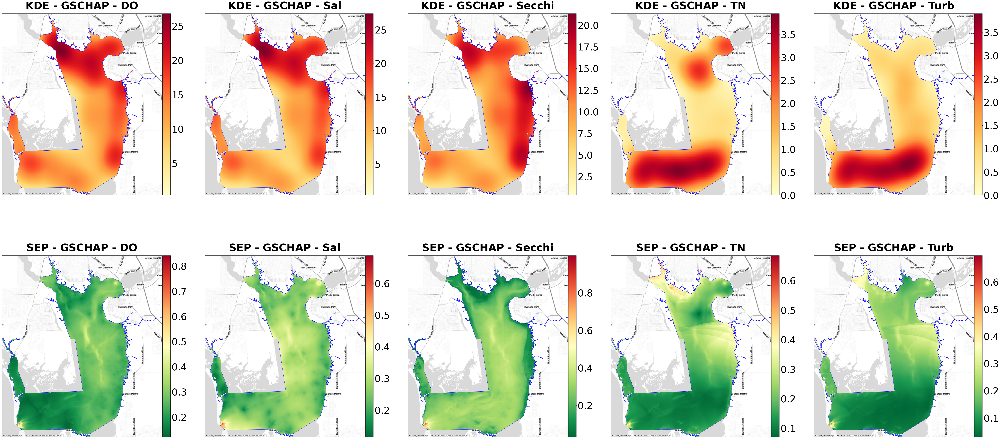

In [29]:
GapAnalysis.plot_pairs(kde_sep_files, 'Gasparilla Sound-Charlotte Harbor Aquatic Preserve', boundary, 80, 20)

## 5.2 Estero Bay  <a class="anchor" id="reg_plot_pair_eb"></a>

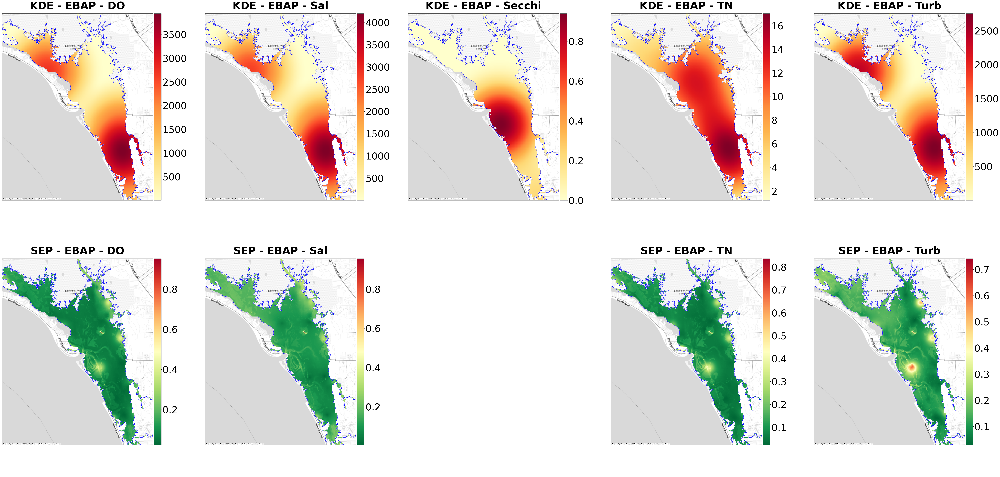

In [30]:
GapAnalysis.plot_pairs(kde_sep_files, 'Estero Bay Aquatic Preserve', boundary, 80, 20)

##  5.3 Big Bend <a class="anchor" id="reg_plot_pair_bb"></a>

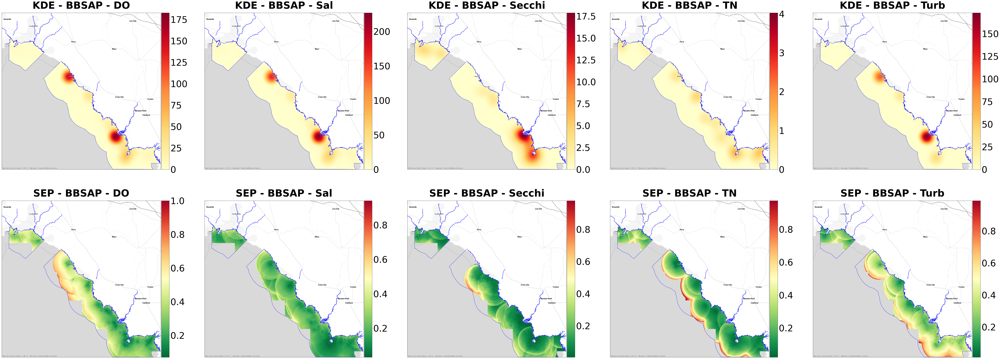

In [31]:
GapAnalysis.plot_pairs(kde_sep_files, 'Big Bend Seagrasses Aquatic Preserve', boundary, 85, 16)

## 5.4 Biscayne Bay <a class="anchor" id="reg_plot_pair_bbay"></a>

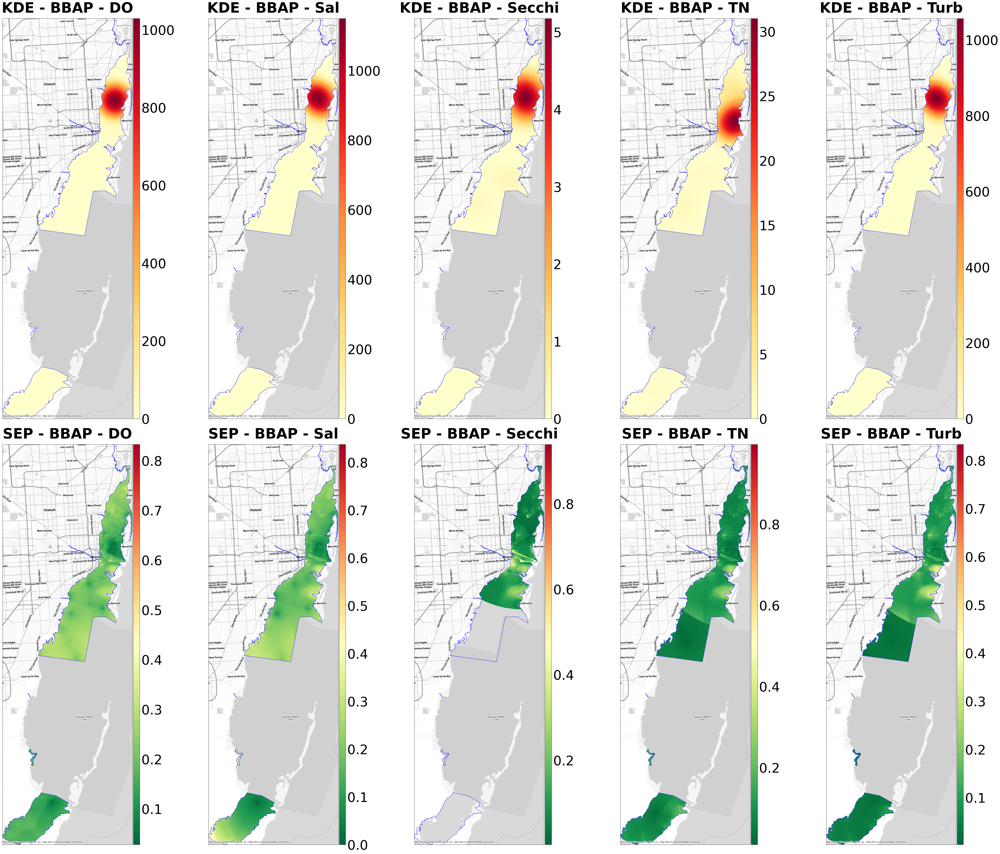

In [32]:
GapAnalysis.plot_pairs(kde_sep_files, 'Biscayne Bay Aquatic Preserve', boundary, 60, 25)

## 5.5 Guana Tolomato <a class="anchor" id="reg_plot_pair_gtm"></a>

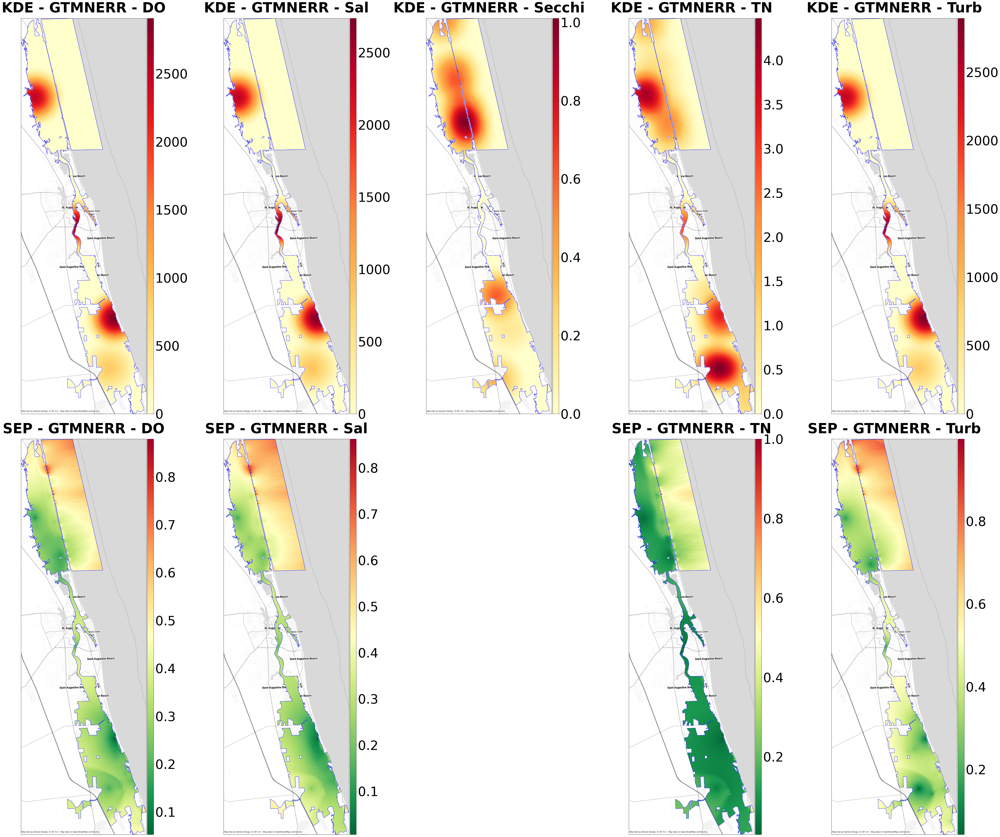

In [33]:
GapAnalysis.plot_pairs(kde_sep_files, 'Guana Tolomato Matanzas National Estuarine Research Reserve', boundary, 60, 25)